In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df = pd.read_csv('/Users/franckatteaka/Desktop/cours/Semester III/ML_for_finance/Data/data_clean.csv',sep = ",",parse_dates = True,index_col = 0 )

In [3]:
df.head()

,sentiment eu,sentiment ch,kofbarometer,kof mpc,1J,2J,3J,4J,5J,6J,7J,8J,9J,10J,15J,20J,30J
Date,,,,,,,,,,,,,,,,,
2007-04-02,112.3,117.499994,101.798591,0.176471,2.412,2.402,2.414,2.462,2.521,2.574,2.619,2.656,2.686,2.710,2.784,2.821,2.858
2007-04-03,112.3,117.499994,101.798591,0.176471,2.414,2.420,2.441,2.490,2.546,2.595,2.636,2.670,2.697,2.718,2.784,2.818,2.851
2007-04-04,112.3,117.499994,101.798591,0.176471,2.431,2.430,2.448,2.498,2.553,2.603,2.644,2.677,2.704,2.725,2.791,2.824,2.856
2007-04-05,112.3,117.499994,101.798591,0.176471,2.439,2.425,2.449,2.506,2.568,2.621,2.663,2.697,2.724,2.746,2.812,2.845,2.878
2007-04-10,112.3,117.499994,101.798591,0.176471,2.441,2.444,2.477,2.538,2.600,2.653,2.694,2.727,2.754,2.775,2.839,2.871,2.903


In [4]:
df.iloc[:,0:4] = df.iloc[:,0:4].apply(lambda x: x/(10 * x.max())).copy()
df.iloc[:,4:] = df.iloc[:,4:].copy()/100

In [5]:
df.head()

,sentiment eu,sentiment ch,kofbarometer,kof mpc,1J,2J,3J,4J,5J,6J,7J,8J,9J,10J,15J,20J,30J
Date,,,,,,,,,,,,,,,,,
2007-04-02,0.097908,0.099382,0.077428,0.025668,0.02412,0.02402,0.02414,0.02462,0.02521,0.02574,0.02619,0.02656,0.02686,0.02710,0.02784,0.02821,0.02858
2007-04-03,0.097908,0.099382,0.077428,0.025668,0.02414,0.02420,0.02441,0.02490,0.02546,0.02595,0.02636,0.02670,0.02697,0.02718,0.02784,0.02818,0.02851
2007-04-04,0.097908,0.099382,0.077428,0.025668,0.02431,0.02430,0.02448,0.02498,0.02553,0.02603,0.02644,0.02677,0.02704,0.02725,0.02791,0.02824,0.02856
2007-04-05,0.097908,0.099382,0.077428,0.025668,0.02439,0.02425,0.02449,0.02506,0.02568,0.02621,0.02663,0.02697,0.02724,0.02746,0.02812,0.02845,0.02878
2007-04-10,0.097908,0.099382,0.077428,0.025668,0.02441,0.02444,0.02477,0.02538,0.02600,0.02653,0.02694,0.02727,0.02754,0.02775,0.02839,0.02871,0.02903


In [17]:
def sub_range(df,nb_years = None):

    last = df.index.date.max()
    first =  last.replace(year = last.year - nb_years)
    df2 = df[ df.index.date >= first].copy()

    return df2
    
def yields_plot(df):
    
    terms = ['1J', '2J','3J', '4J', '5J', '6J','7J', '8J', '9J', '10J', '15J', '20J', '30J']

    figure, axes = plt.subplots(3,1,figsize=(15,12))
    plt.figure(figsize = (10,6))
    df.loc[:,terms].plot(ax=axes[0])
    df.loc[:,df.columns.str.contains('sentiment')].plot(ax=axes[1])
    df.loc[:,df.columns.str.contains('kof')].plot(ax=axes[2])
    plt.show()




    #df[ df.index.date >= first].loc[:,terms[pos[0]:pos[1]]].plot(figsize = (15,8)).plot()
    #df[ df.index.date >= first].iloc[:,0:4].plot(figsize = (15,8)).plot()
    


# Yields and economic factors plots 

## Full data range

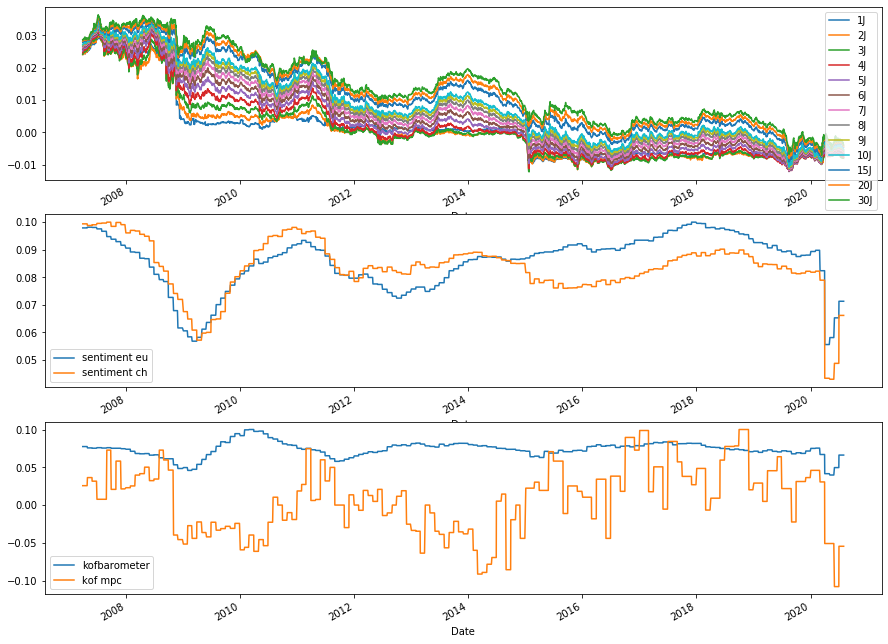

<Figure size 720x432 with 0 Axes>

In [19]:
yields_plot(df)

<Figure size 864x720 with 0 Axes>

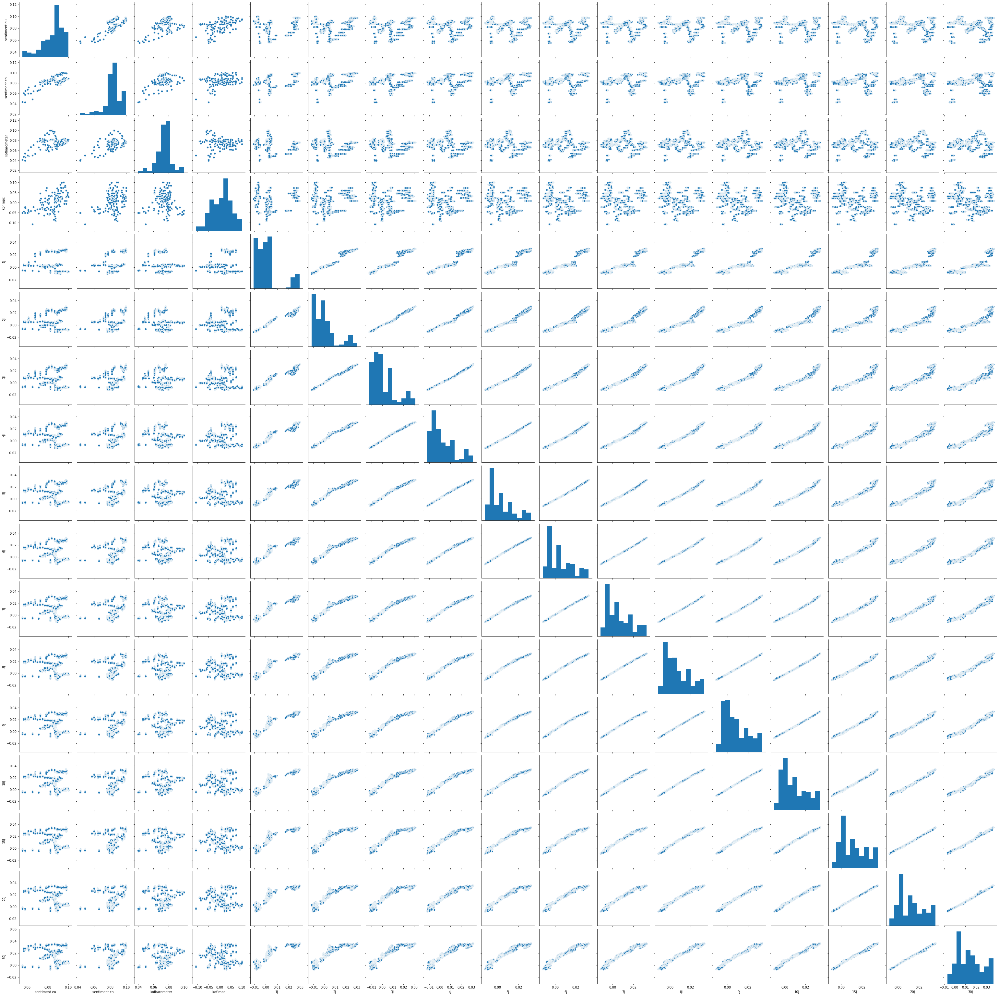

In [20]:
plt.figure(figsize = (12,10))
sns.pairplot(df)

## Last 5 years of data

In [21]:
# number of years we want to plot
df_5year = sub_range(df,nb_years = 5)

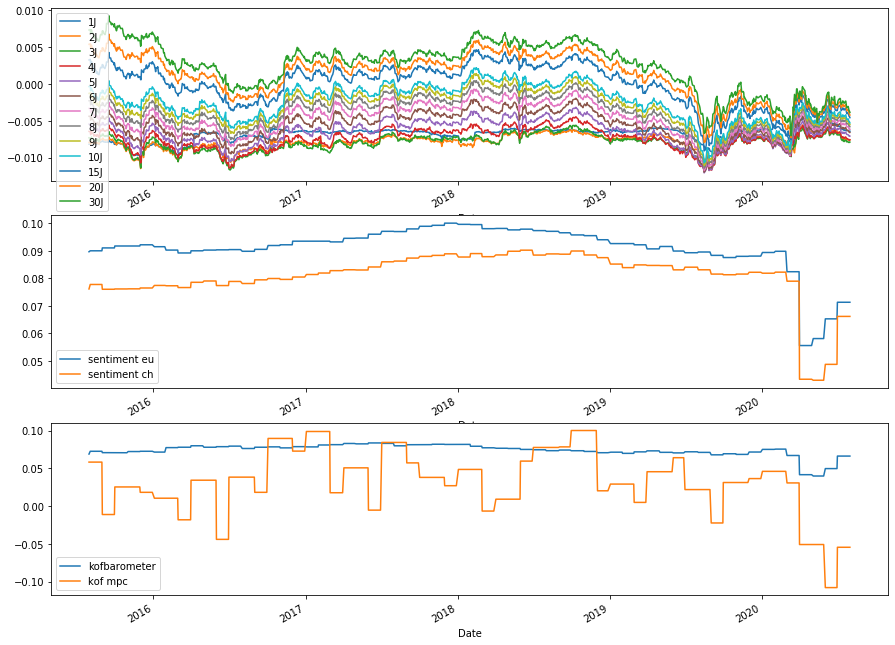

<Figure size 720x432 with 0 Axes>

In [22]:
yields_plot(df_5year)

<Figure size 864x720 with 0 Axes>

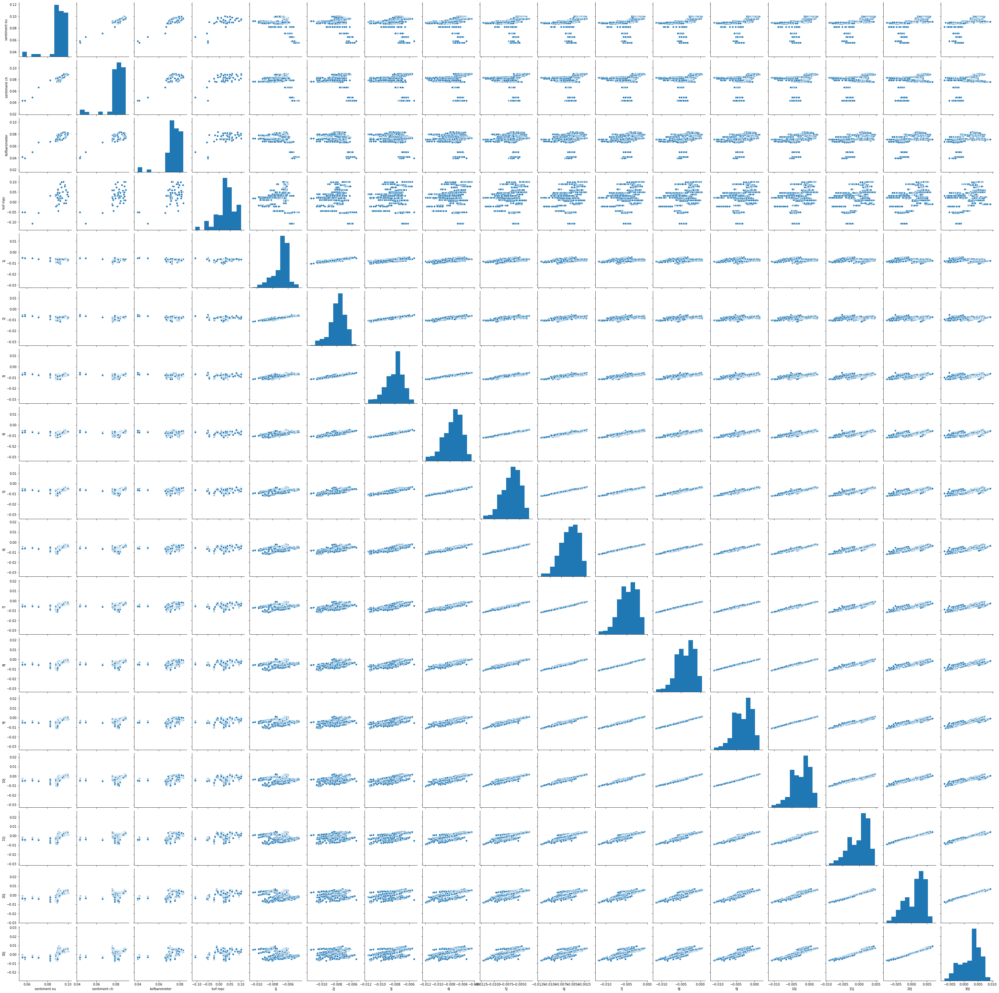

In [23]:
plt.figure(figsize = (12,10))
sns.pairplot(df_5year)

In [27]:
def rolling_diff(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).apply(lambda x: x.iloc[-1] - x.iloc[0]).copy()).dropna()
    return df2.join(df.iloc[:,4:])   
def rolling_vol(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).std().copy()).dropna()
    return df2.join(df.iloc[:,4:])   
    
def rolling_mean(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).mean().copy()).dropna()
    return df2.join(df.iloc[:,4:])   

def rolling_max(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).max().copy()).dropna()
    return df2.join(df.iloc[:,4:])   

def rolling_min(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).min().copy()).dropna()
    return df2.join(df.iloc[:,4:])   

def rolling_growth(df,freq):
    df2 = (df.iloc[:,0:4].rolling(freq).apply(lambda x: (x.iloc[-1] - x.iloc[0])/x.iloc[0]).copy()).dropna()
    return df2.join(df.iloc[:,4:])   


### Rolling differences

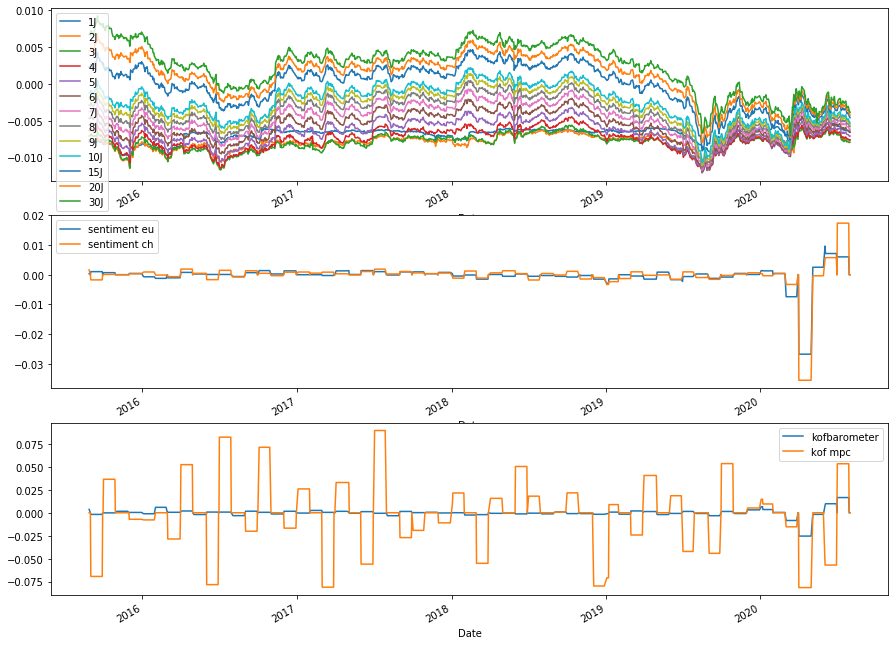

<Figure size 720x432 with 0 Axes>

In [28]:
yields_plot(rolling_diff(df_5year,21))

<Figure size 864x720 with 0 Axes>

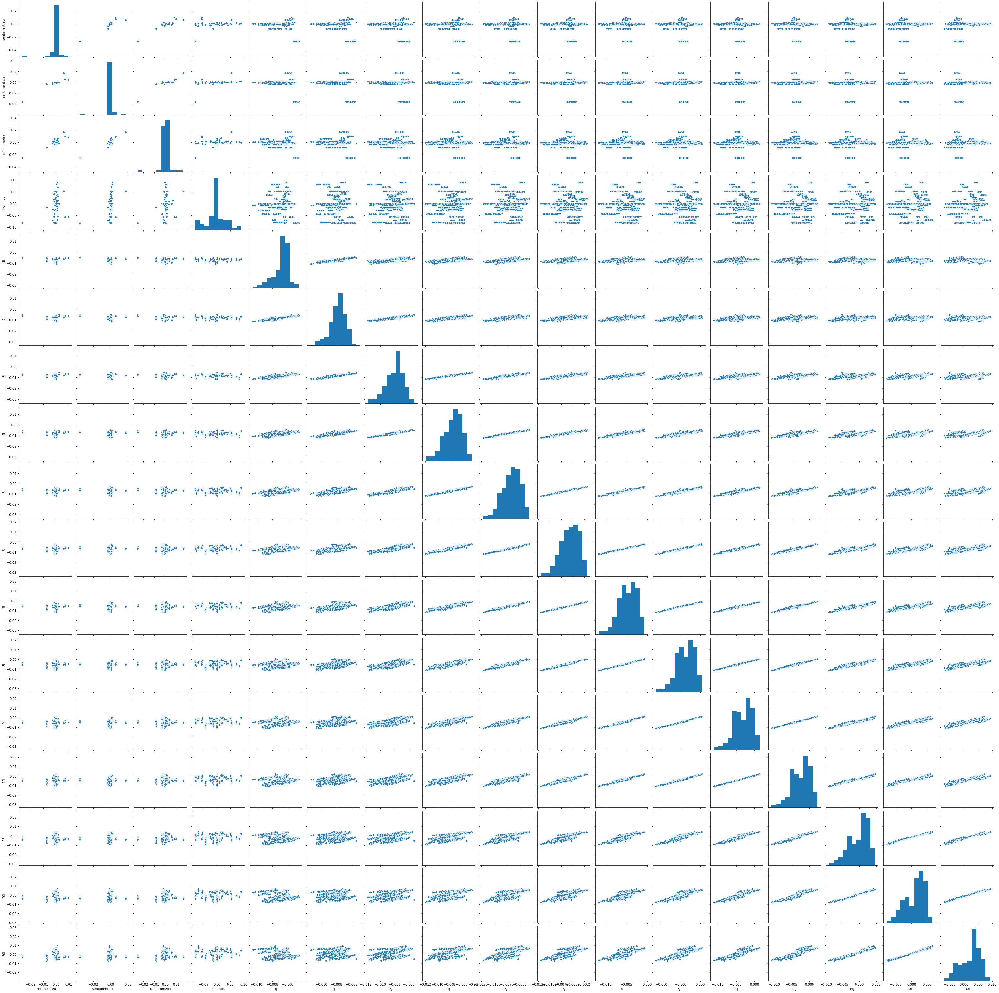

In [29]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_diff(df_5year,21))

### Rolling growth

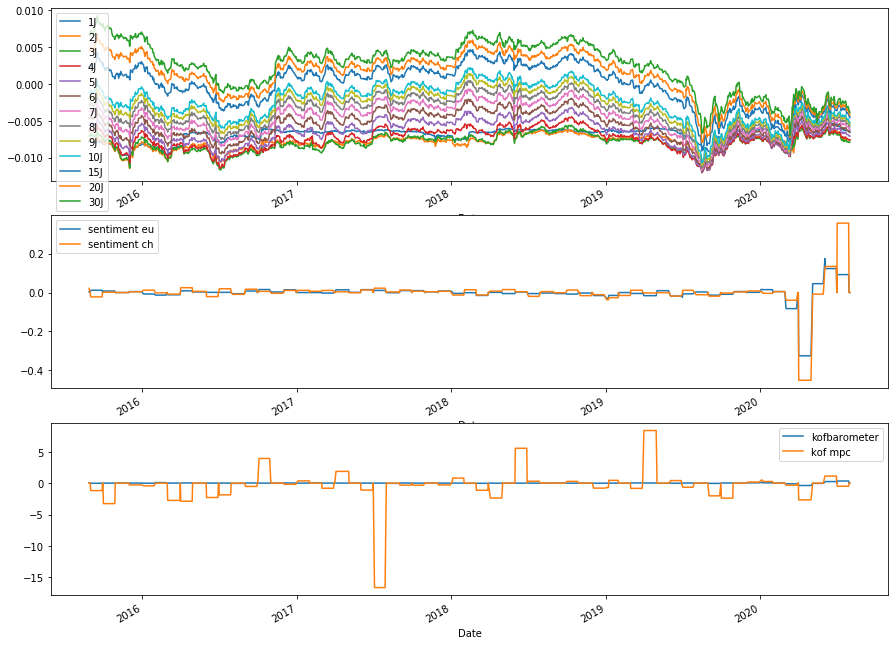

<Figure size 720x432 with 0 Axes>

In [30]:
yields_plot(rolling_growth(df_5year,21))

<Figure size 864x720 with 0 Axes>

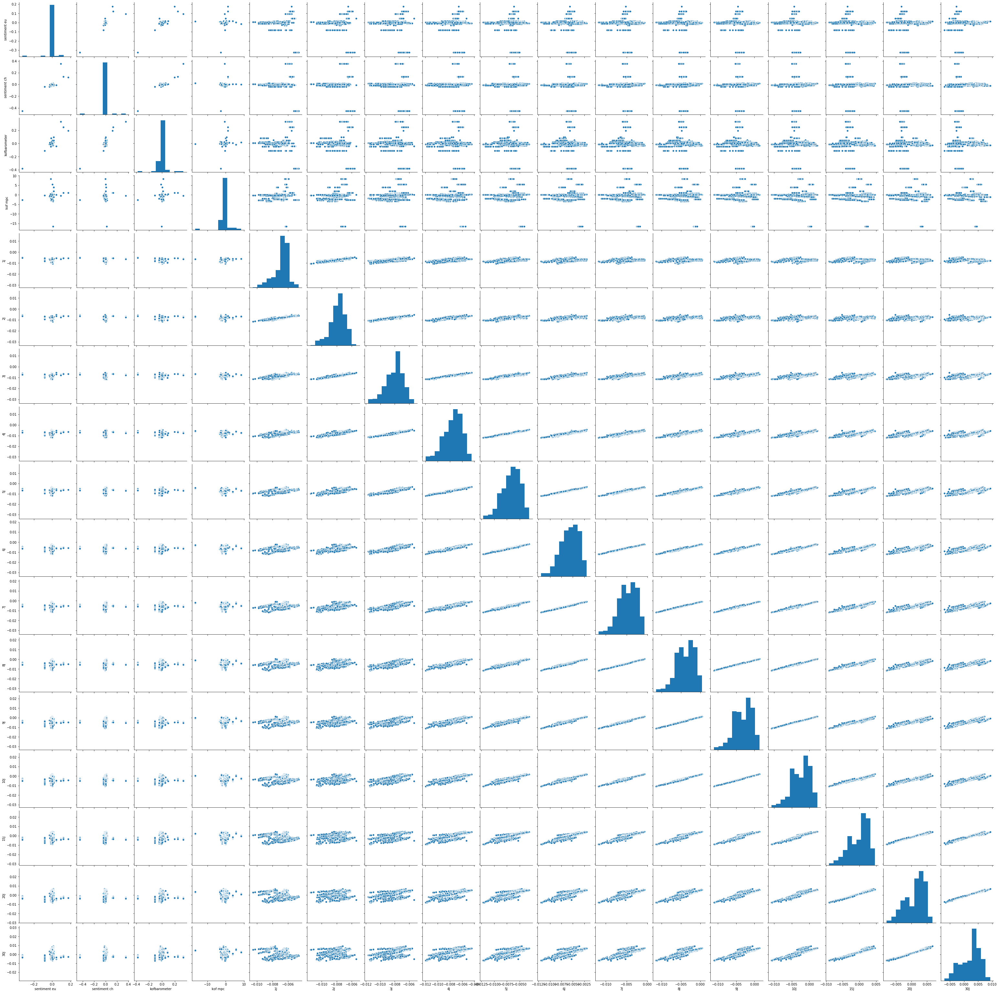

In [31]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_growth(df_5year,21))

### Rolling vol

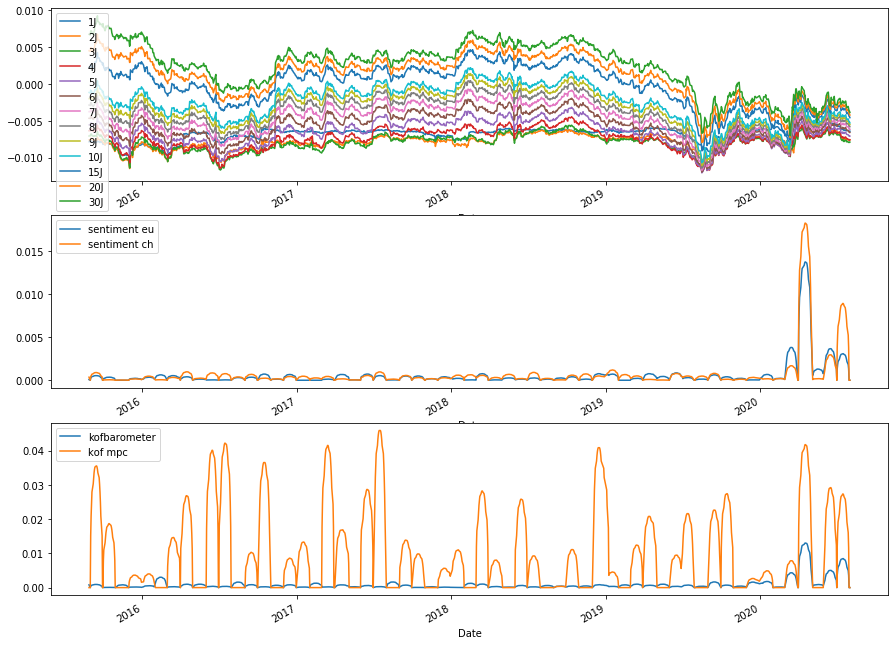

<Figure size 720x432 with 0 Axes>

In [32]:
yields_plot(rolling_vol(df_5year,21))

<Figure size 864x720 with 0 Axes>

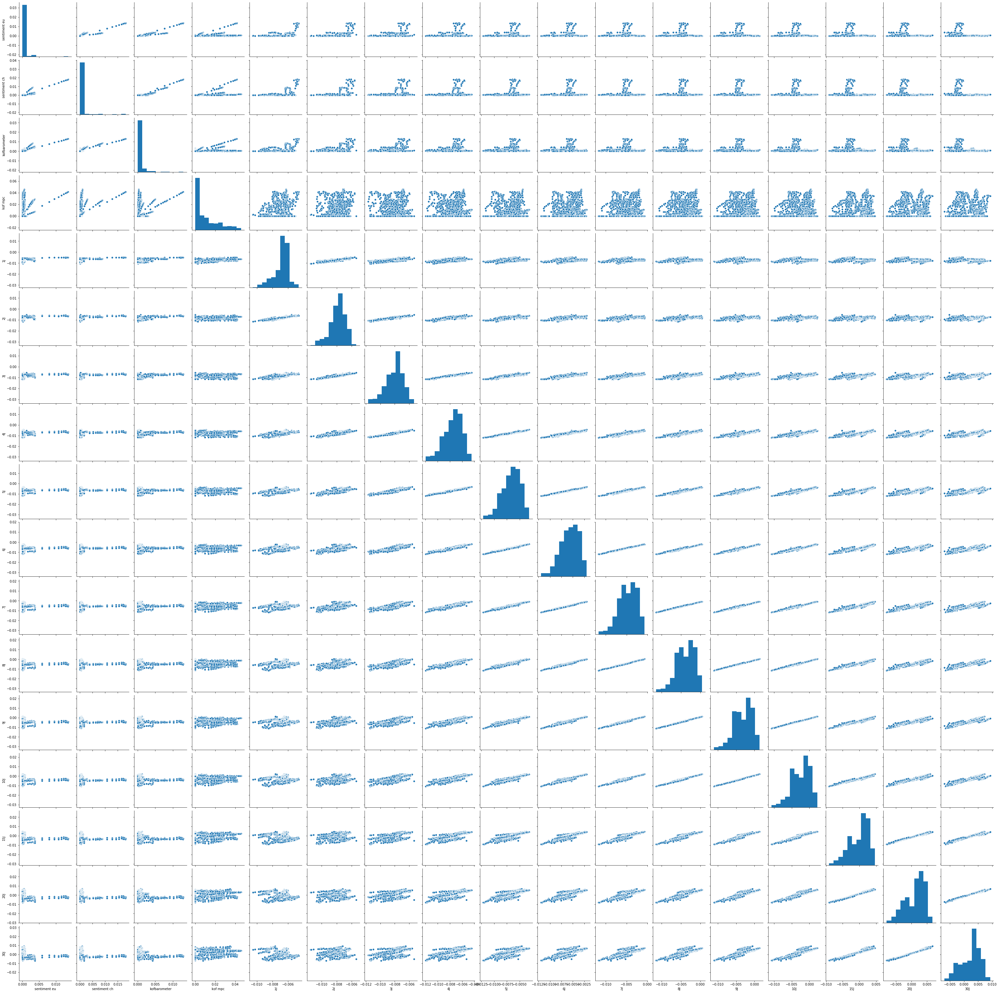

In [34]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_vol(df_5year,21))

### Rolling mean 

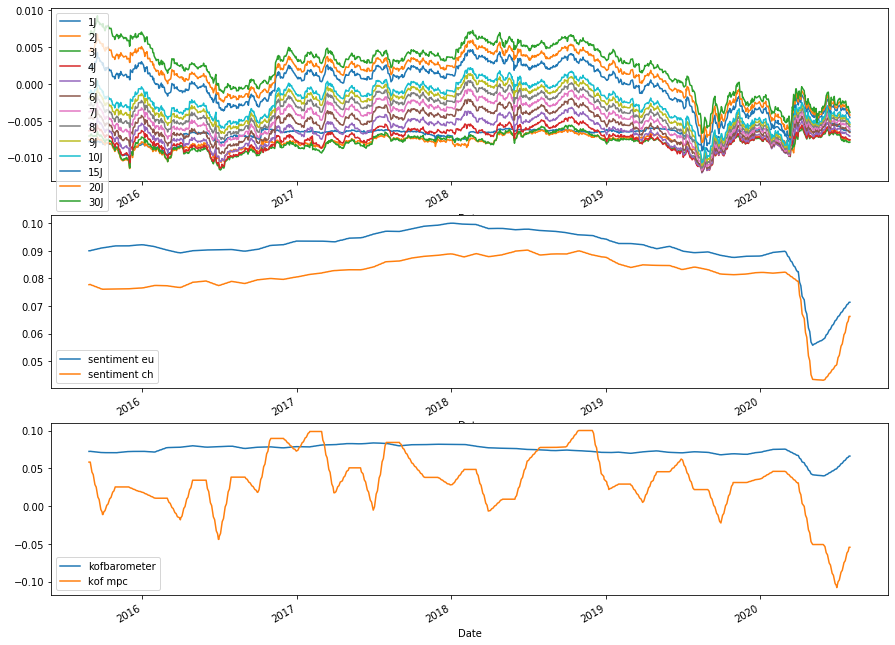

<Figure size 720x432 with 0 Axes>

In [36]:
yields_plot(rolling_mean(df_5year,21))

<Figure size 864x720 with 0 Axes>

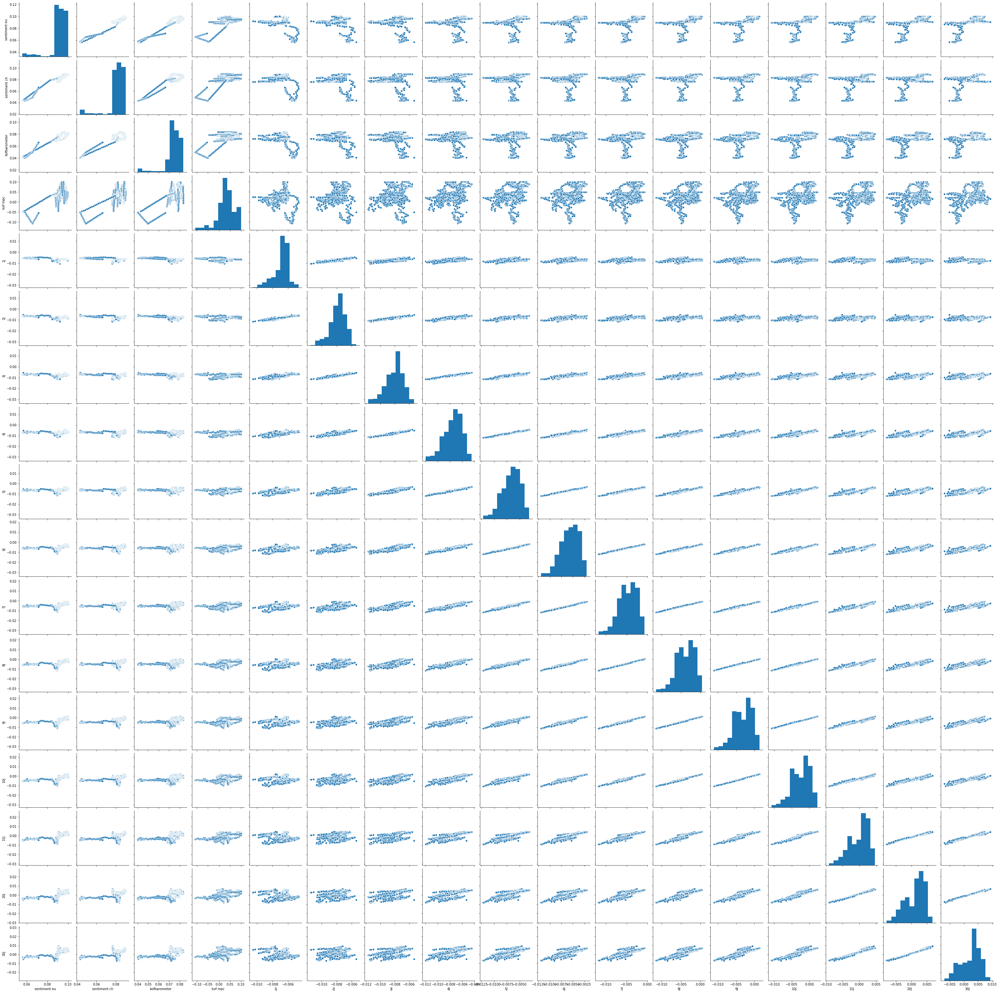

In [37]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_mean(df_5year,21))

### Rolling max

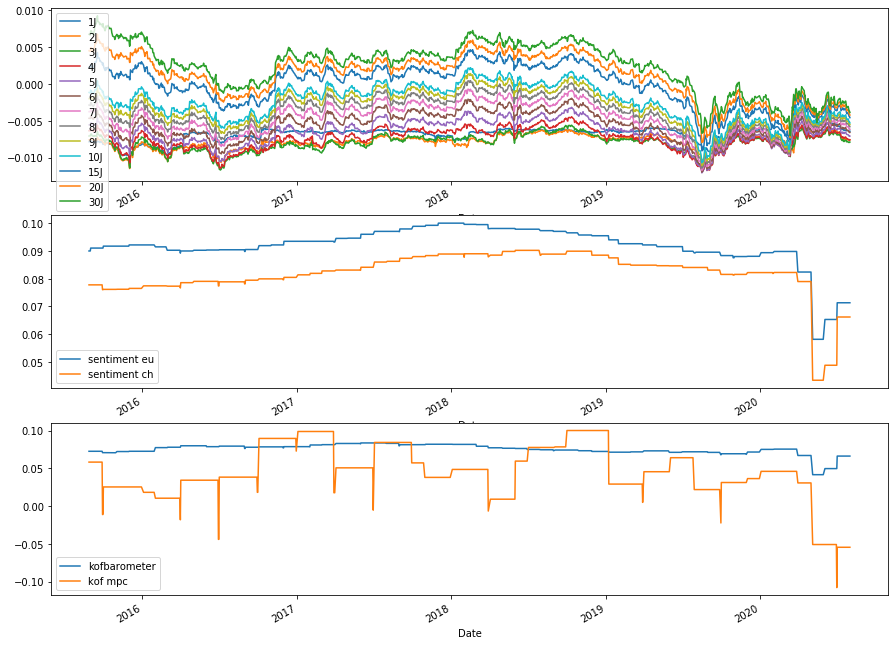

<Figure size 720x432 with 0 Axes>

In [38]:
yields_plot(rolling_max(df_5year,21))

<Figure size 864x720 with 0 Axes>

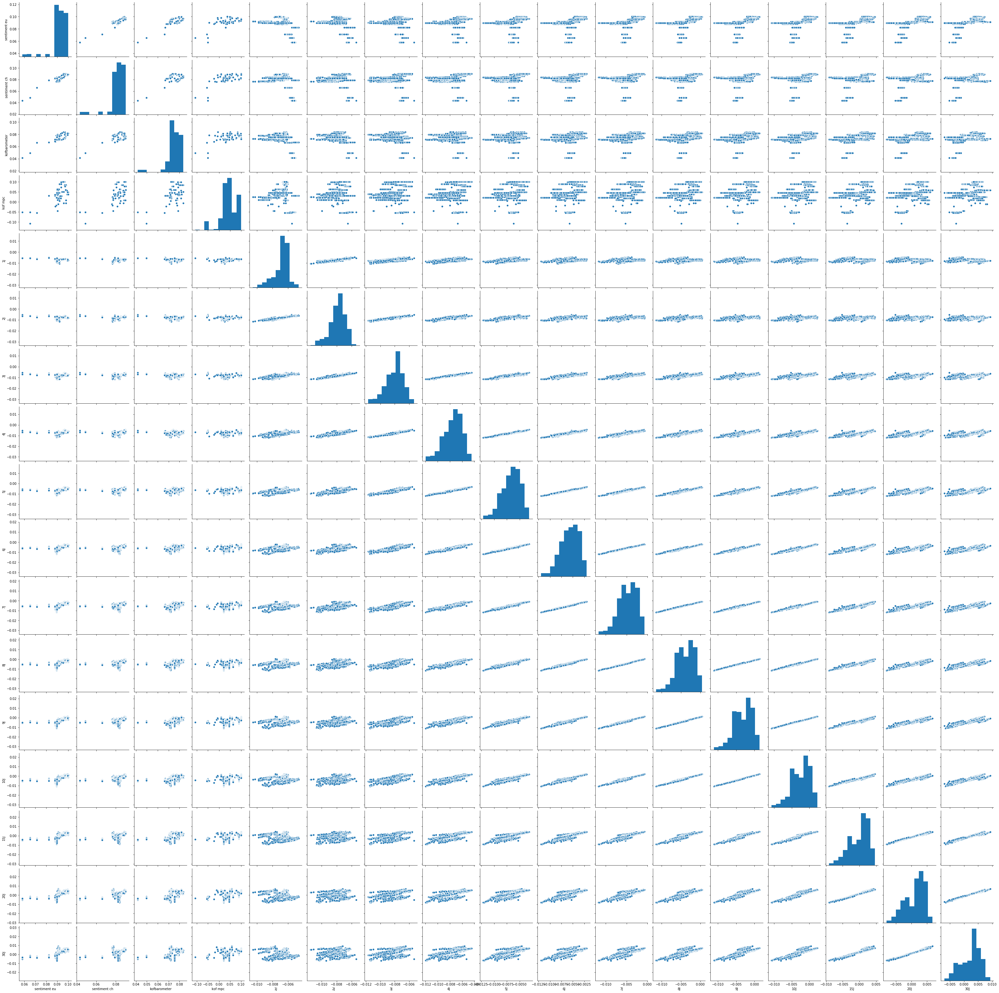

In [39]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_max(df_5year,21))

### Rolling min

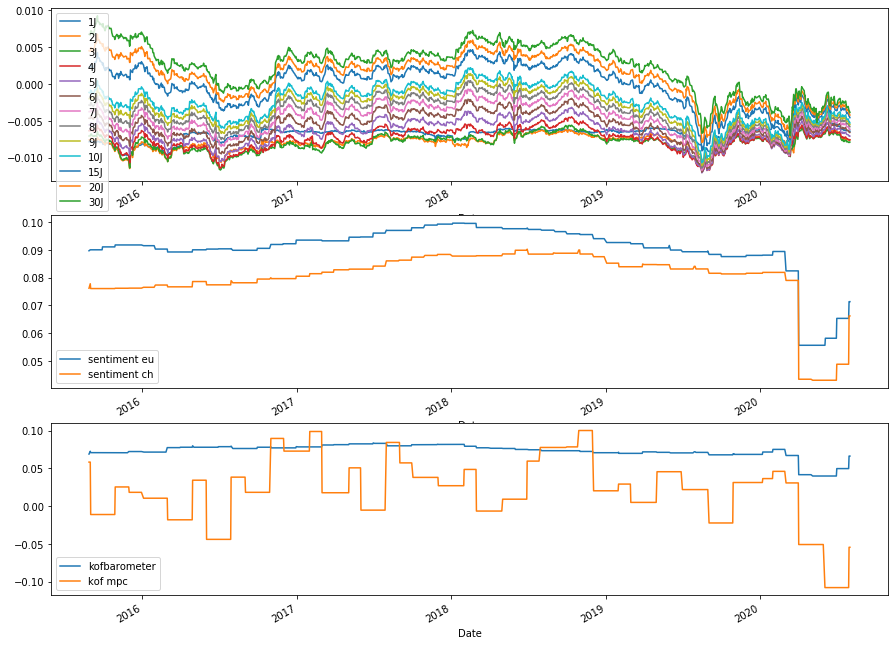

<Figure size 720x432 with 0 Axes>

In [40]:
yields_plot(rolling_min(df_5year,21))

<Figure size 864x720 with 0 Axes>

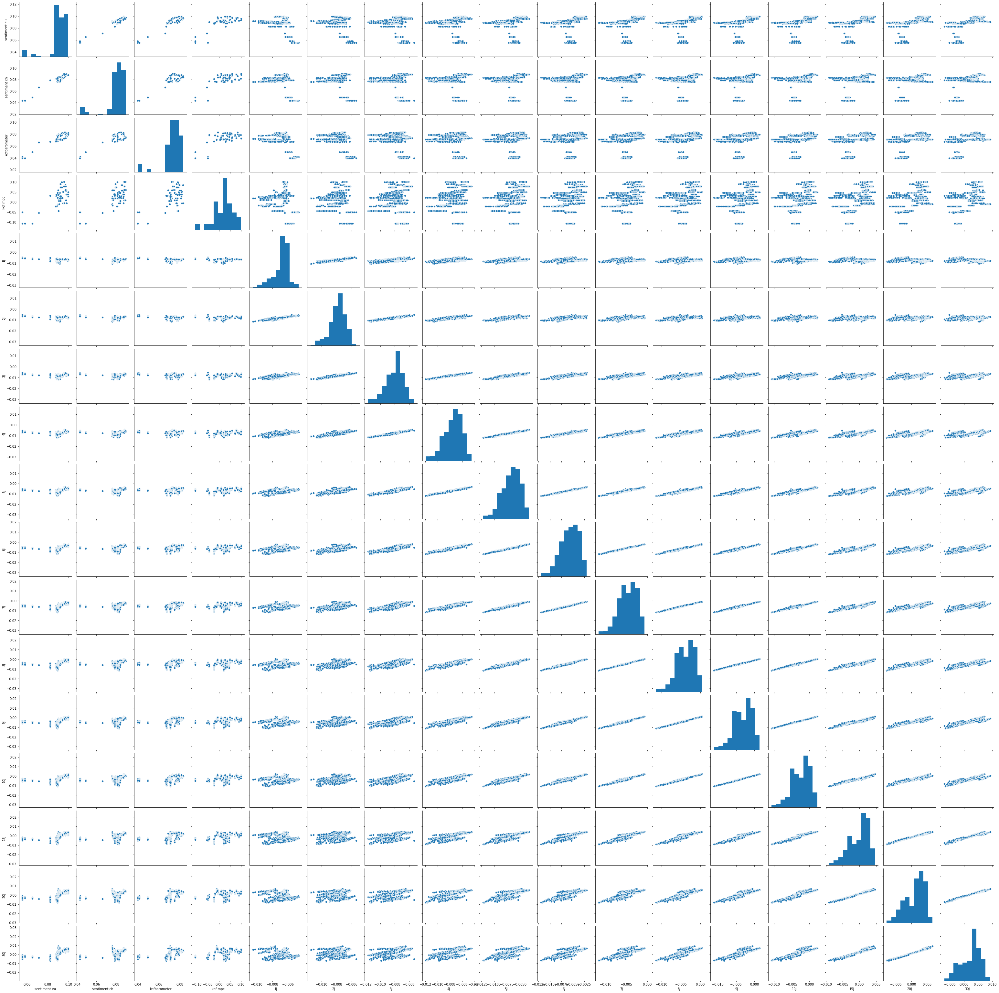

In [41]:
plt.figure(figsize = (12,10))
sns.pairplot(rolling_min(df_5year,21))

## Nelson Siegel Swensson shapes parameters

In [ ]:
# !pip install nelson_siegel_svensson

In [45]:
from nelson_siegel_svensson.calibrate import calibrate_ns_ols

In [46]:
def nelson_para(yields):
    t =  np.array([1.0, 2.0, 3.0, 4.0, 5.0, 6.0,7.0, 8.0, 9.0, 10.0, 15.0, 20.0,30.0])
    curve, status = calibrate_ns_ols(t, yields, tau0 = 1.0)  # starting value of 1.0 for the optimization of tau
    p = np.array([curve.beta0, curve.beta1,curve.beta2, curve.tau])
    return p
    

In [47]:
nelson_df = (df.iloc[:,4:].T).apply(nelson_para).T

In [48]:
nelson_df.columns = ['beta0', 'beta1', 'beta2', 'tau']

In [49]:
 new_df = nelson_df.join(df)

In [68]:

def rolling_mean(df,freq):
    df2 = (df.iloc[:,0:8].rolling(freq).mean().copy()).dropna()
    return df2.join(df.iloc[:,8:])   

def rolling_max(df,freq):
    df2 = (df.iloc[:,0:8].rolling(freq).max().copy()).dropna()
    return df2.join(df.iloc[:,8:])   

def rolling_min(df,freq):
    df2 = (df.iloc[:,0:8].rolling(freq).min().copy()).dropna()
    return df2.join(df.iloc[:,8:])   

def rolling_growth(df,freq):
    df2 = (df.iloc[:,0:8].rolling(freq).apply(lambda x: (x.iloc[-1] - x.iloc[0])/x.iloc[0]).copy()).dropna()
    return df2.join(df.iloc[:,8:])   

def nl_plot(df):
    
    terms = ['1J', '2J','3J', '4J', '5J', '6J','7J', '8J', '9J', '10J', '15J', '20J', '30J']

    figure, axes = plt.subplots(3,1,figsize=(15,12))
    plt.figure(figsize = (10,6))
    df.loc[:,terms].plot(ax=axes[0])
    df.loc[:,['beta0', 'beta1', 'beta2']].plot(ax=axes[1])
    df.loc[:,['tau']].plot(ax=axes[2])
    plt.show()



In [53]:
df3 = sub_range(new_df,nb_years = 5)

### parameters plots

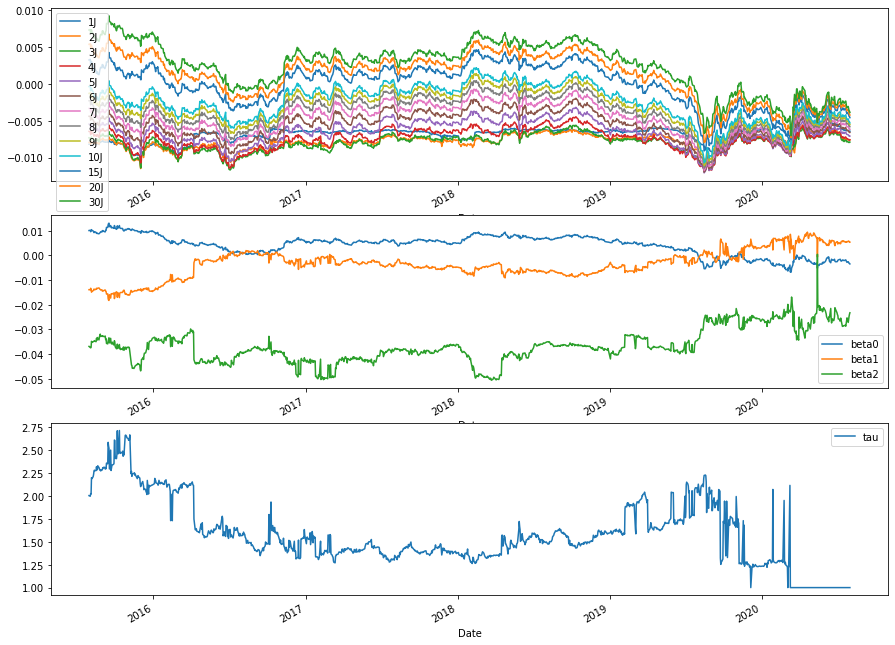

<Figure size 720x432 with 0 Axes>

In [61]:
nl_plot(df3)

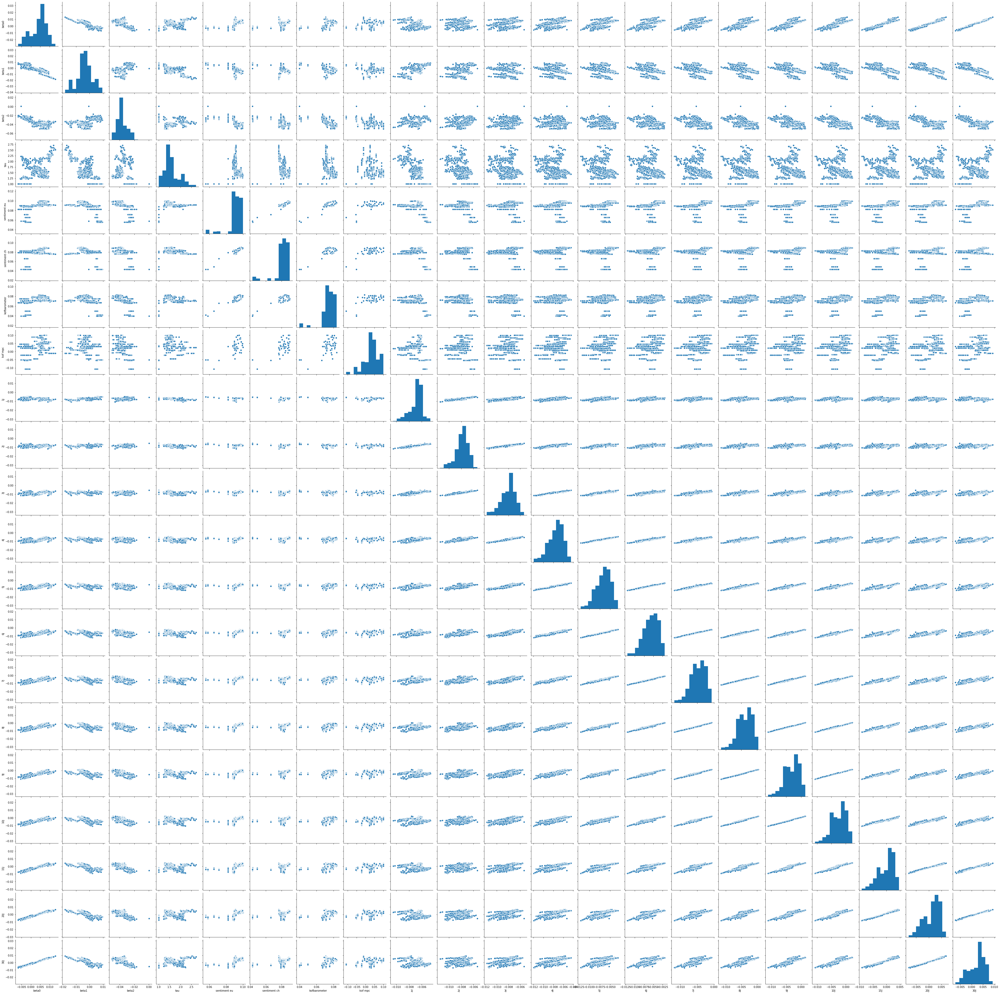

In [62]:
sns.pairplot(df3)

### Rolling mean

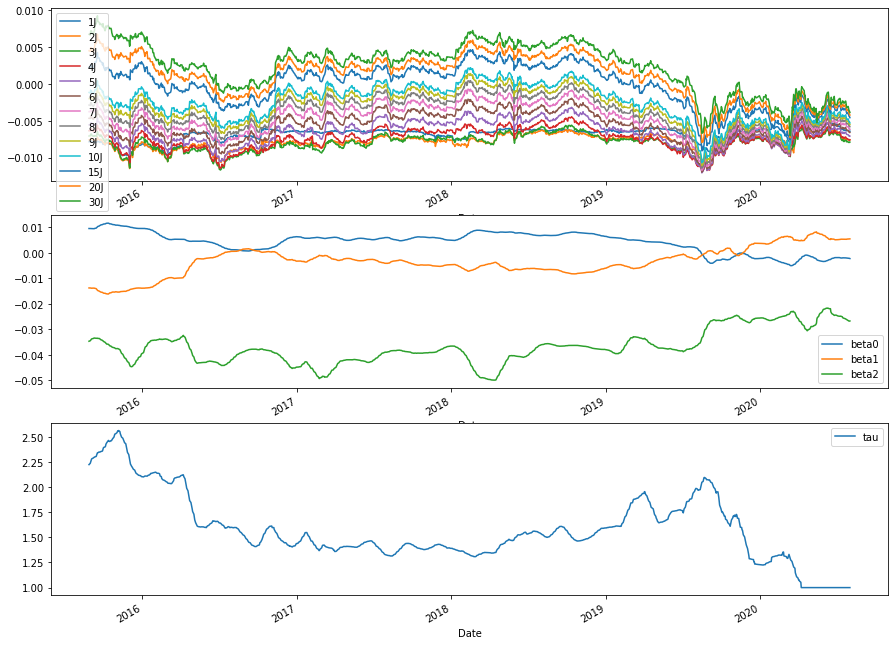

<Figure size 720x432 with 0 Axes>

In [66]:
nl_plot(rolling_mean(df3,21))

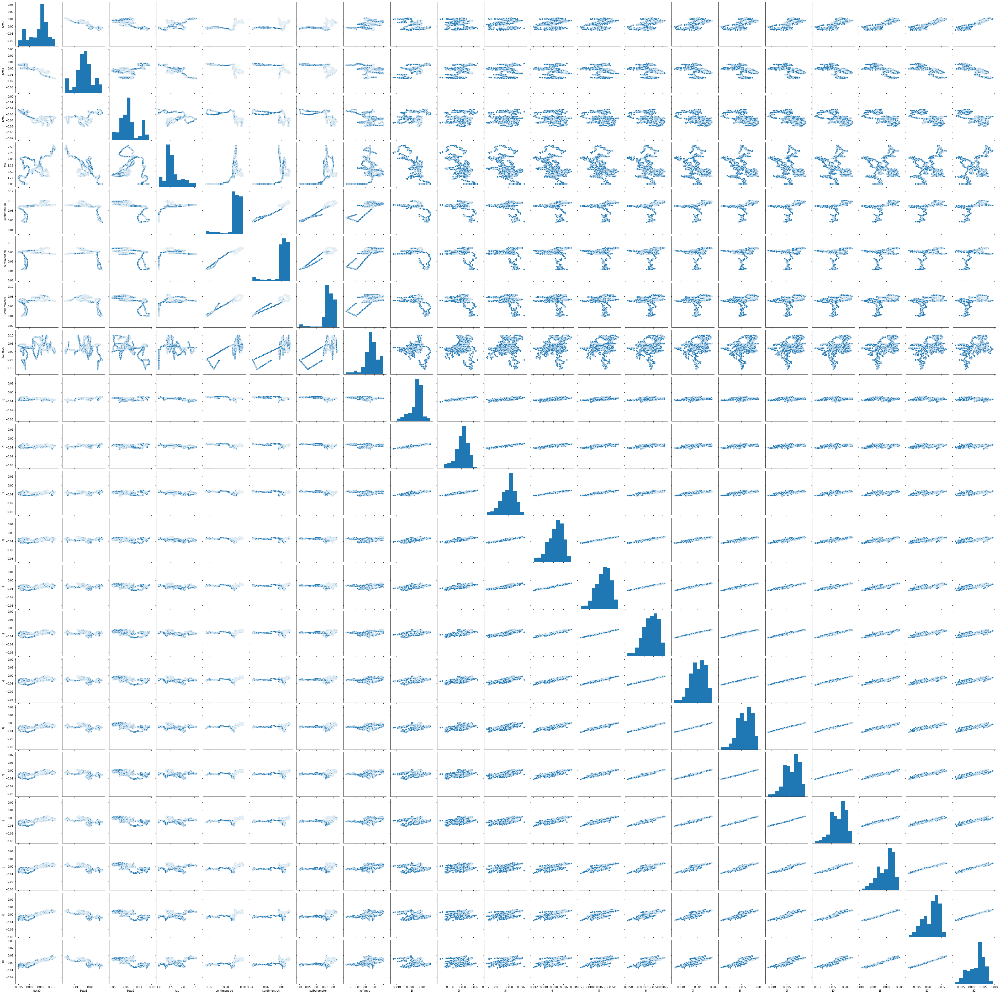

In [67]:
sns.pairplot(rolling_mean(df3,21))

### Rolling growth

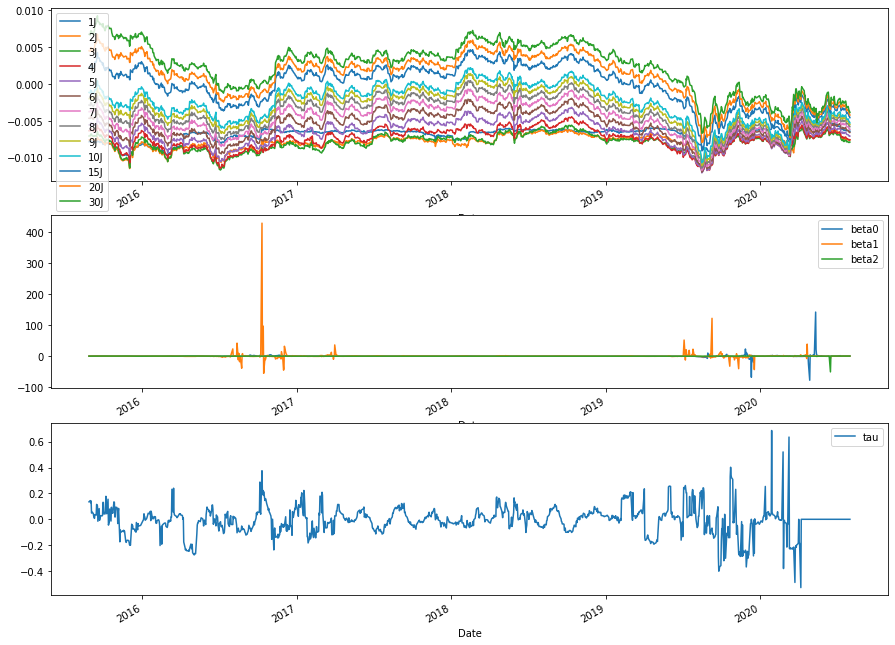

<Figure size 720x432 with 0 Axes>

In [70]:
nl_plot(rolling_growth(df3,21))

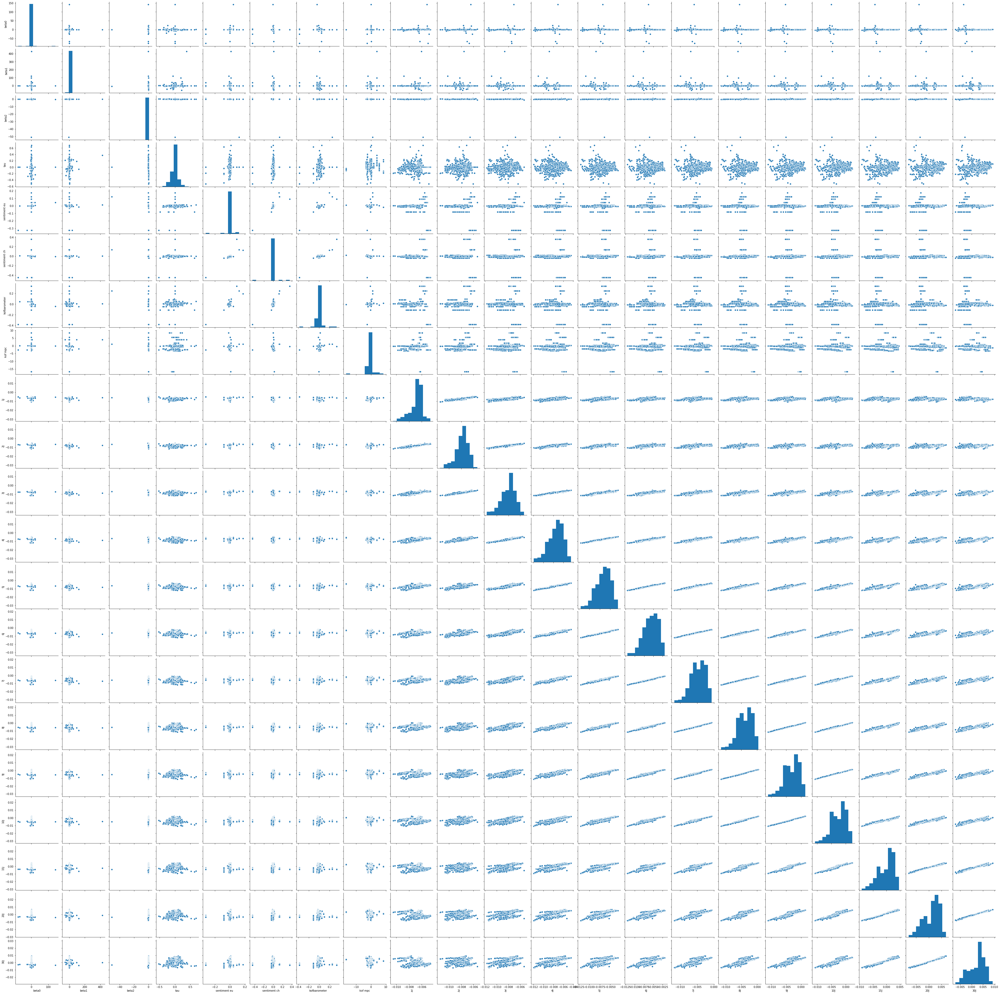

In [71]:
sns.pairplot(rolling_growth(df3,21))

### Rolling max

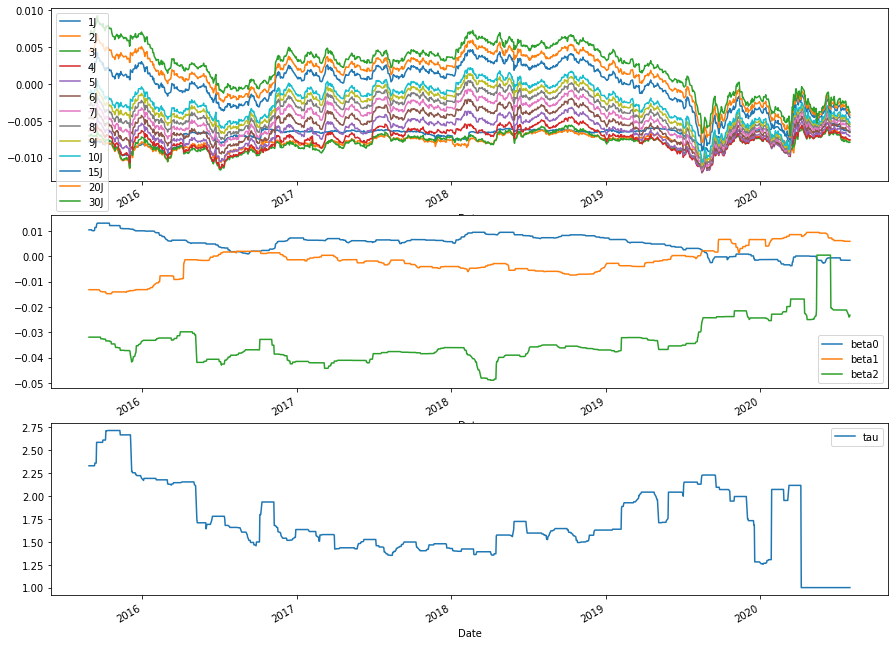

<Figure size 720x432 with 0 Axes>

In [73]:
nl_plot(rolling_max(df3,21))

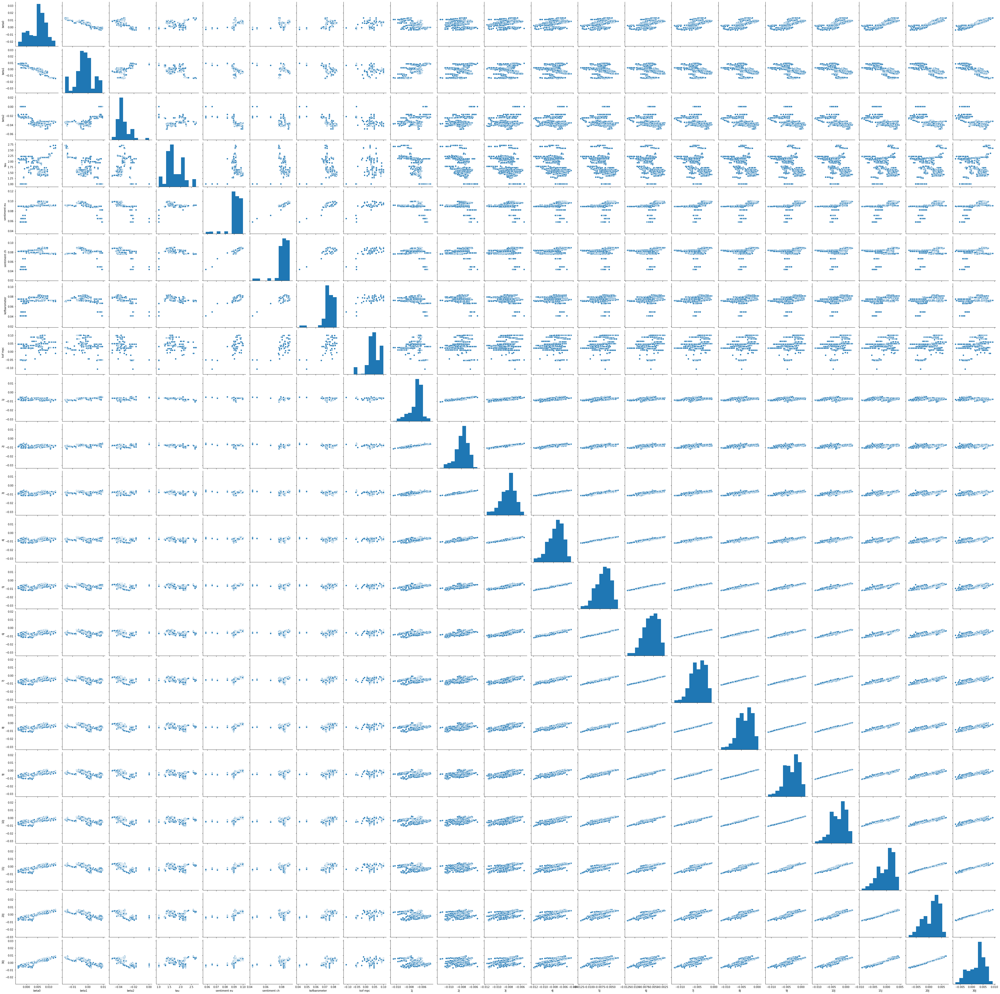

In [74]:
sns.pairplot(rolling_max(df3,21))

### Rolling min

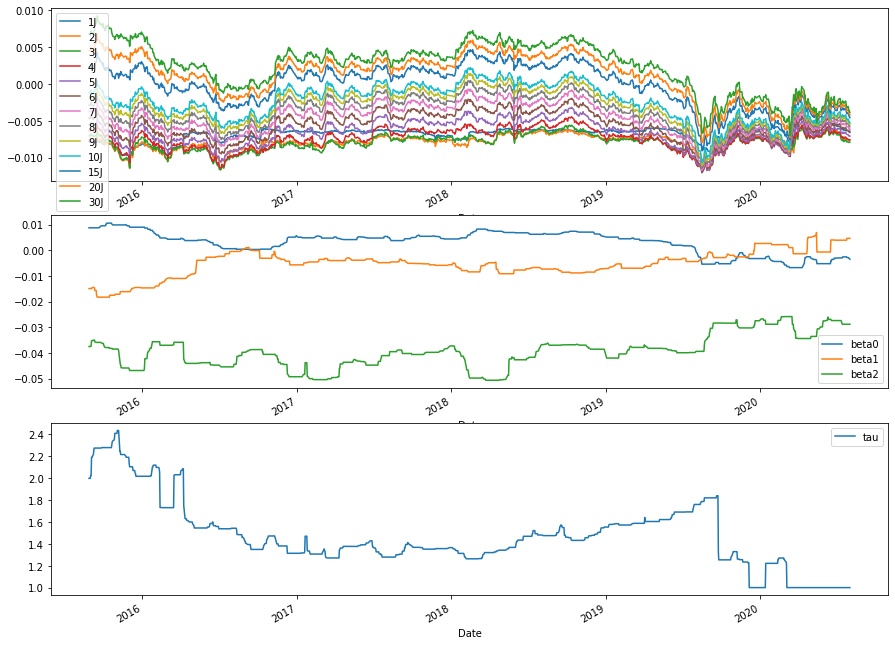

<Figure size 720x432 with 0 Axes>

In [76]:
nl_plot(rolling_min(df3,21))

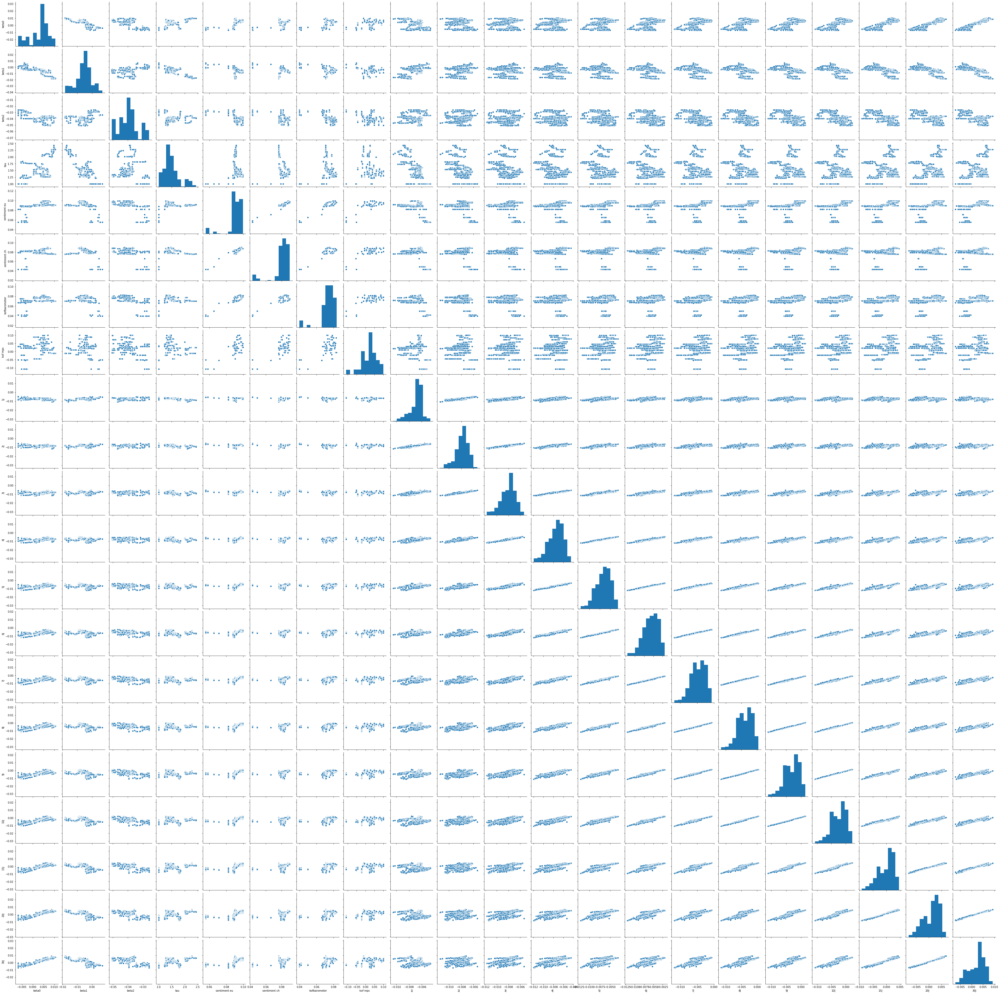

In [79]:
sns.pairplot(rolling_min(df3,21))